In [ ]:
% Design complete pipeline with cpu threading (chunking), use classical method of parsing 

In [1]:
!pip install pymupdf
!python.exe -m pip install --upgrade pip

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


[(178, 0, 2333, 881, 8, 'DeviceCMYK', '', 'Im0', 'DCTDecode'), (106, 309, 406, 424, 8, 'Indexed', '', 'Im0', 'FlateDecode')]


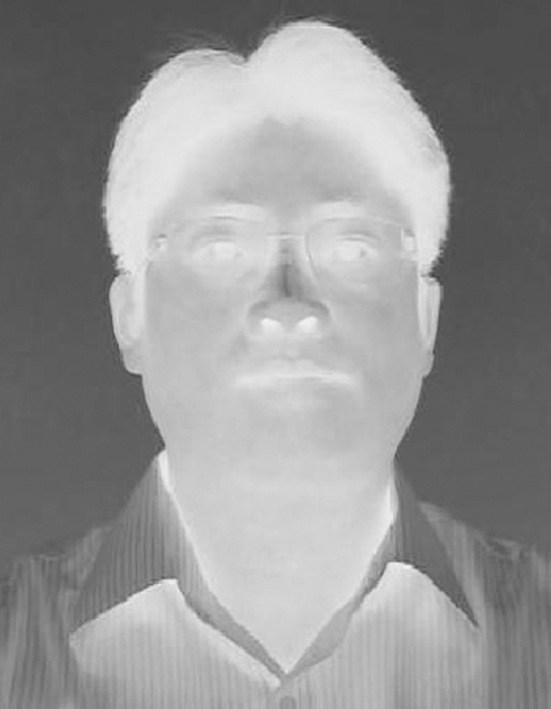

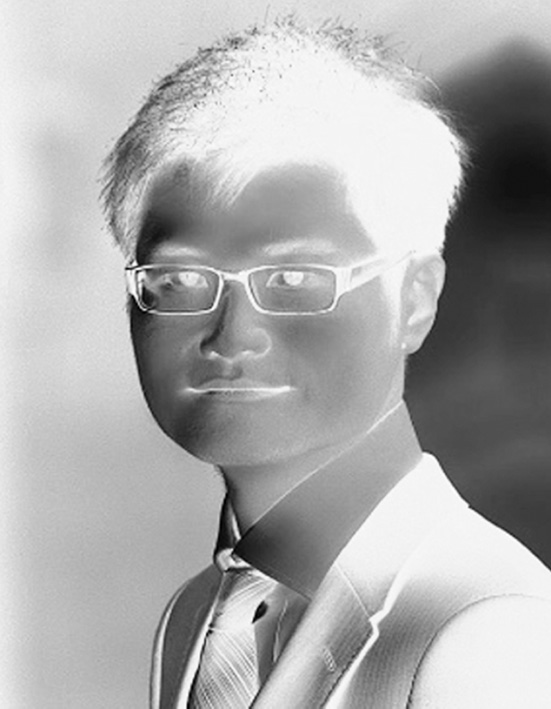

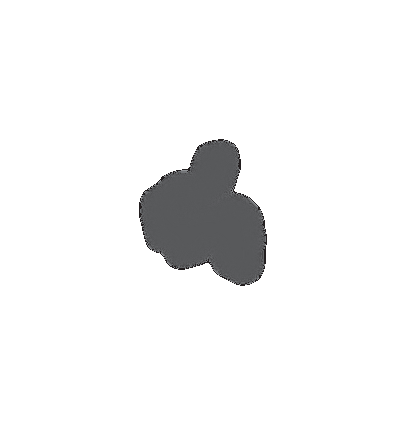

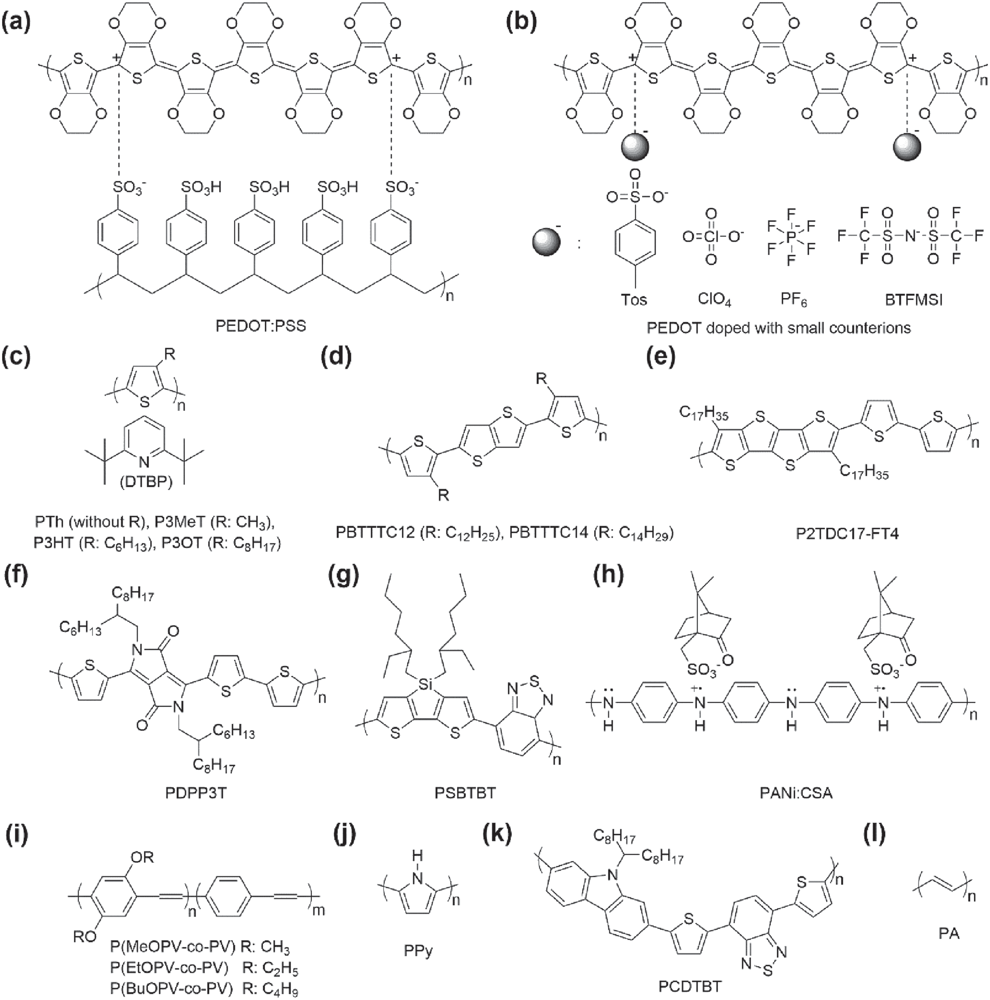

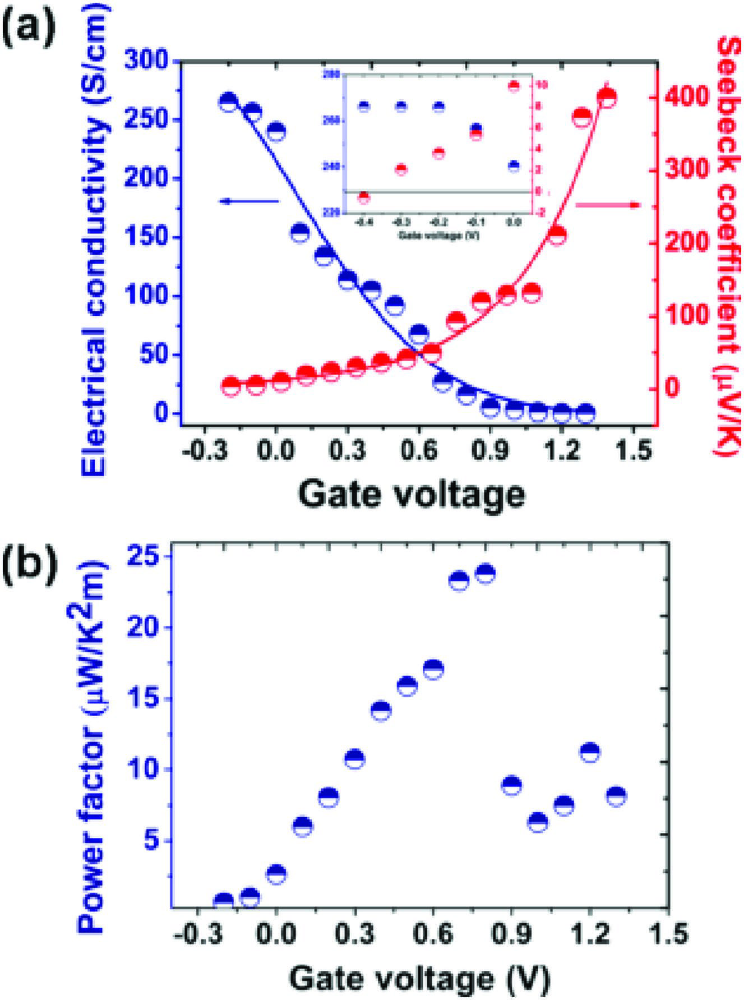

...

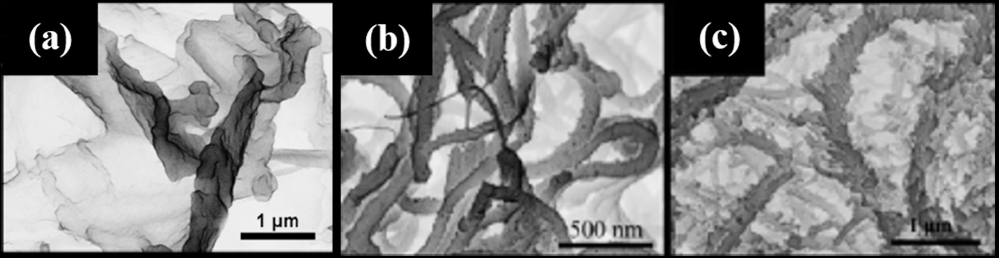

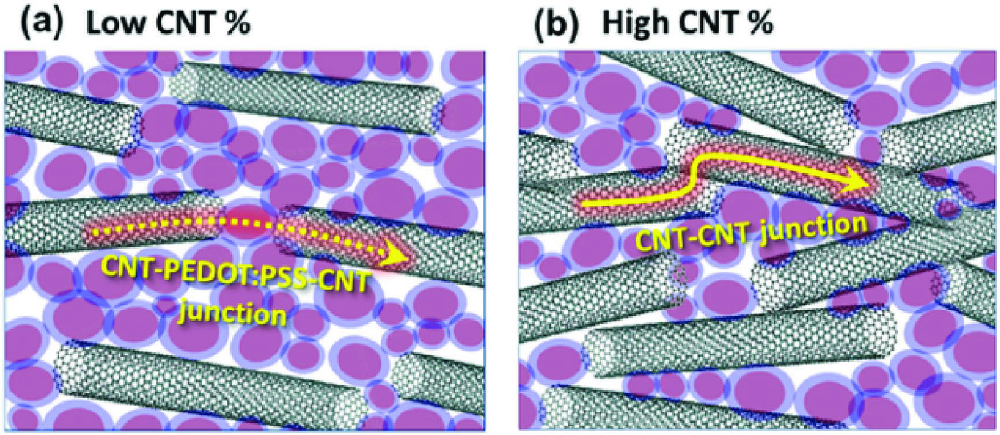

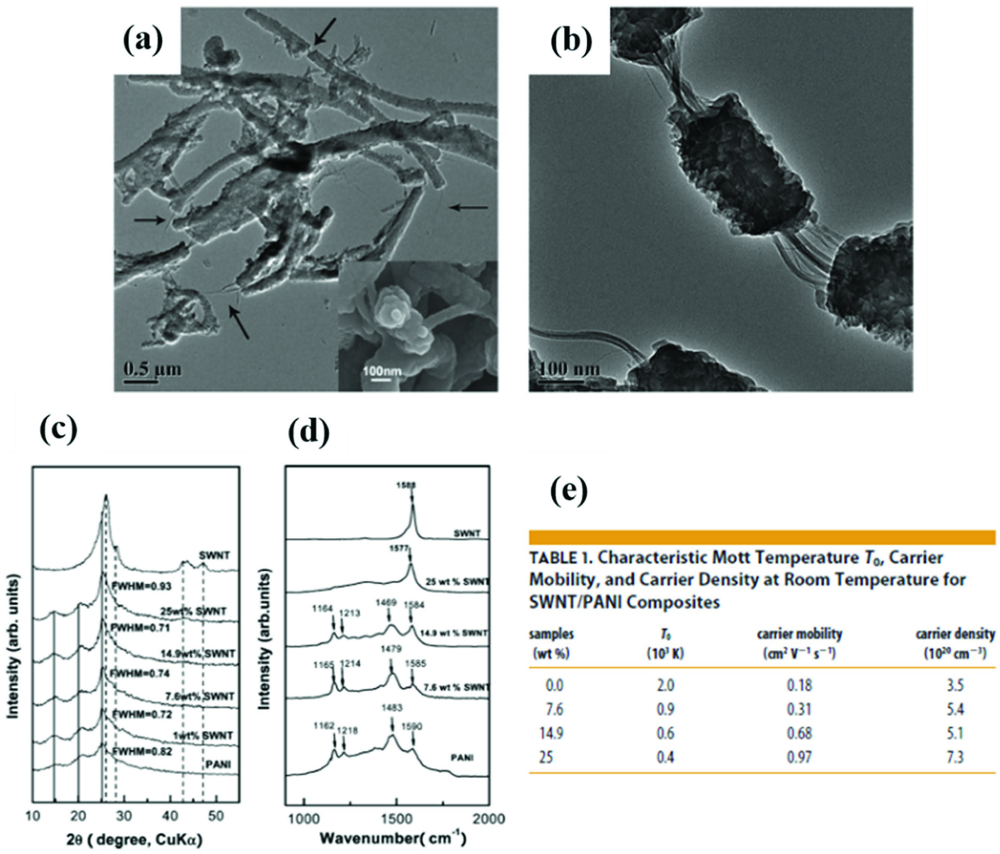

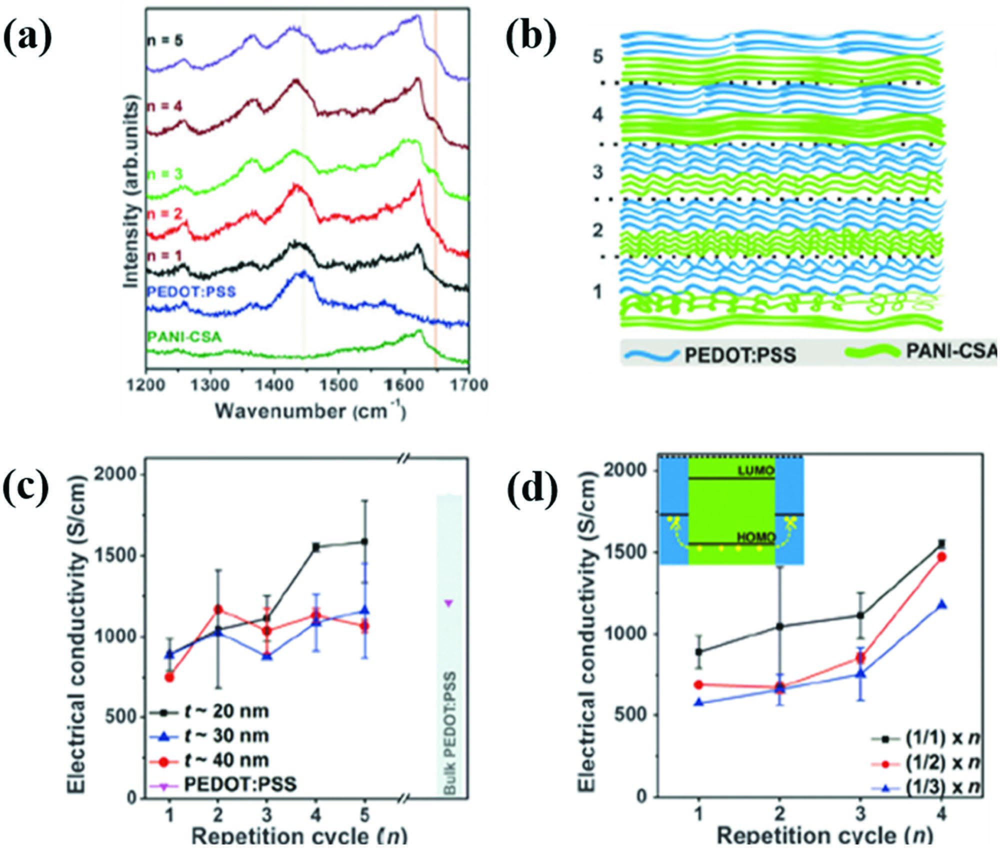

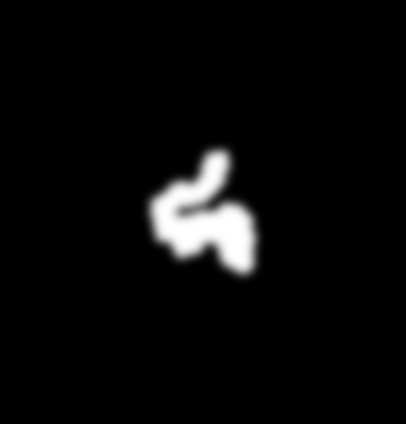


Page 1
  Embedded images: 1
  Vector drawing objects: 350
  Has text: True
    - image xref=106, format=png, size=406x424

Page 2
  Embedded images: 3
  Vector drawing objects: 390
  Has text: True
    - image xref=81, format=jpeg, size=551x709
    - image xref=82, format=jpeg, size=551x709
    - image xref=106, format=png, size=406x424

Page 3
  Embedded images: 2
  Vector drawing objects: 384
  Has text: True
    - image xref=111, format=png, size=2333x2356
    - image xref=106, format=png, size=406x424

Page 4
  Embedded images: 2
  Vector drawing objects: 363
  Has text: True
    - image xref=124, format=jpeg, size=1327x1783
    - image xref=106, format=png, size=406x424

Page 5
  Embedded images: 3
  Vector drawing objects: 363
  Has text: True
    - image xref=134, format=jpeg, size=2000x1013
    - image xref=135, format=png, size=2333x1983
    - image xref=106, format=png, size=406x424

Page 6
  Embedded images: 2
  Vector drawing objects: 387
  Has text: True
    - image xref=

In [2]:
import fitz  # pip install pymupdf
import io
from PIL import Image
from IPython.display import display
pdf_path = "Macromolecular Rapid Communications - 2018 - Yao - Recent Development of Thermoelectric Polymers and Composites.pdf"
doc = fitz.open(pdf_path)

images2 = doc.get_page_images(11)
print(images2)
lenXREF = doc.xref_length()

for xref in range(1, lenXREF):
    obj = doc.xref_get_key(xref, "Subtype")

    if obj[1] == "/Image":
        imgdata = doc.extract_image(xref)

        pil_image = Image.open(io.BytesIO(imgdata["image"]))
        display(pil_image)

print("=====================")

for page_index in range(len(doc)):
    page = doc[page_index]
    images = page.get_images(full=True)  # list of embedded images
    drawings = page.get_drawings()       # vector paths (lines/curves)
    text = page.get_text("text").strip() # extracted text

    print(f"\nPage {page_index+1}")
    print(f"  Embedded images: {len(images)}")
    print(f"  Vector drawing objects: {len(drawings)}")
    
    print(f"  Has text: {bool(text)}")
    
    # If you want details about each raster image:
    for img in images[:5]:
        xref = img[0]
        info = doc.extract_image(xref)
        print(f"    - image xref={xref}, format={info.get('ext')}, size={info.get('width')}x{info.get('height')}")


In [3]:
pip install pymupdf pillow pytesseract opencv-python


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [5]:
import fitz
import io
import cv2
import pytesseract
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"
import numpy as np
from PIL import Image

pdf_path = "Macromolecular Rapid Communications - 2018 - Yao - Recent Development of Thermoelectric Polymers and Composites.pdf"
doc = fitz.open(pdf_path)

# keywords
Y_KEYWORDS = ["seebeck", "thermopower", "µv/k", "uv/k", "v/k"]
X_KEYWORDS = ["conductivity", "sigma", "σ", "s/cm", "s cm", "s/m"]

def normalize(text):
    return text.lower().replace(" ", "").replace("\n", "")

def contains_any(text, keywords):
    return any(k in text for k in keywords)

def ocr_region(img):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.resize(gray, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)
    gray = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    return pytesseract.image_to_string(gray, config="--psm 6")

def is_seebeck_vs_conductivity(pil_img):
    img = cv2.cvtColor(np.array(pil_img), cv2.COLOR_RGB2BGR)
    h, w, _ = img.shape

    # crop axis regions
    y_axis_crop = img[int(0.1*h):int(0.9*h), int(0.0*w):int(0.2*w)]
    x_axis_crop = img[int(0.75*h):int(1.0*h), int(0.2*w):int(0.9*w)]

    y_text = normalize(ocr_region(y_axis_crop))
    x_text = normalize(ocr_region(x_axis_crop))

    print("Y axis OCR:", y_text)
    print("X axis OCR:", x_text)

    y_ok = contains_any(y_text, Y_KEYWORDS)
    x_ok = contains_any(x_text, X_KEYWORDS)

    return y_ok and x_ok

# iterate through all images
lenXREF = doc.xref_length()

for xref in range(1, lenXREF):
    obj = doc.xref_get_key(xref, "Subtype")

    if obj[1] == "/Image":
        imgdata = doc.extract_image(xref)
        pil_image = Image.open(io.BytesIO(imgdata["image"]))

        print(f"\nImage XREF {xref}")
        if is_seebeck_vs_conductivity(pil_image):
            print("✔ Seebeck vs Conductivity detected → send to Graph2Table")
        else:
            print("✘ Rejected")



Image XREF 81
Y axis OCR: xf
X axis OCR: de.'ats.7)al}ki
✘ Rejected

Image XREF 82
Y axis OCR: ~~&f$7a?e>.°yooneebbheoer719bs’
X axis OCR: 
✘ Rejected

Image XREF 106
Y axis OCR: 
X axis OCR: 
✘ Rejected

Image XREF 111
Y axis OCR: oooovy/4\so;scnn|“a(cc)rhms'n:ssn~(dtbp)pth(withoutr),p3mep3ht(r:cchy3),p30”cghi7chaosnwn\a»nokpdp(i)orlf_\,
X axis OCR: ~of23hi7np3tpsbtbtpani:csa(j)(k)cehaz(1)hy—cghy7nc}ns—/n|<p*ureuven>-pv)r:ch;ppy\arnpv)r:cohsn~o’
✘ Rejected

Image XREF 124
Y axis OCR: zs2ae22a1rso4ts=&lu(b}—2(b)¢wtzl5o7pi|@=
X axis OCR: )°ws=--_&=03000306o091.21.gatevoltage(v)
✘ Rejected

Image XREF 134
Y axis OCR: remioak
X axis OCR: iesee((81)polarcn)(neutraliz
✘ Rejected

Image XREF 135
Y axis OCR: nfp-typedopant(e)fofof(h)nc.fpinc”faln-typedopani(1)a/_n-
X axis OCR: 2m2)oy,(0)n/nh-=:-lanlaonce~cocp2n-dmbin-df
✘ Rejected

Image XREF 144
Y axis OCR: ce—
X axis OCR: »\@~
✘ Rejected

Image XREF 154
Y axis OCR: yayrpoti2anaf,8fw,
X axis OCR: =aoe1)—4—=aaaooeeff!a©feai*=’radodecytpotdes

Y axis OCR: wd"738|ane3b200109e
X axis OCR: 50010001500o(s/m)
✘ Not the target graph


False

In [53]:
#Checkpoint
from PIL import Image, ImageOps
import pytesseract
import re

# 1) Point pytesseract to your Tesseract install (Windows)
pytesseract.pytesseract.tesseract_cmd = r"C:\Program Files\Tesseract-OCR\tesseract.exe"

Y_KEYWORDS = ["uv/k", "µv/k", "μv/k", "v/k", "u¥/k", "seebeck"]
X_KEYWORDS = ["s/m", "s m", "s·m", "s−1", "s-1", "siemens", "conductivity"]

def preprocess(img: Image.Image) -> Image.Image:
    # basic cleanup for OCR
    img = img.convert("L")  # grayscale
    img = ImageOps.autocontrast(img)
    # upscale helps OCR a lot
    img = img.resize((img.size[0] * 3, img.size[1] * 3))
    # simple threshold
    img = img.point(lambda p: 255 if p > 150 else 0)
    return img

def ocr_text(img: Image.Image) -> str:
    img = preprocess(img)
    # psm 6 assumes a block of text, good general default
    txt = pytesseract.image_to_string(img, config="--oem 3 --psm 6")
    txt = txt.lower()
    # normalize common micro symbols and spacing
    txt = txt.replace("μ", "µ")
    txt = re.sub(r"\s+", " ", txt)
    return txt

def contains_any(text: str, keywords: list[str]) -> bool:
    return any(k in text for k in keywords)

def check_axes(image_path: str):
    img = Image.open(image_path)

    # A) rotate 90 degrees to the right and check y keywords anywhere
    rotated = img.transpose(Image.Transpose.ROTATE_270)
    text_rot = ocr_text(rotated)
    y_ok = contains_any(text_rot, Y_KEYWORDS)

    # B) original image and check x keywords anywhere
    text_orig = ocr_text(img)
    x_ok = contains_any(text_orig, X_KEYWORDS)

    return {
        "y_match": y_ok,
        "x_match": x_ok,
        "rotated_ocr_preview": text_rot[:300],
        "original_ocr_preview": text_orig[:300],
    }

# Example
result = check_axes(r"Example_SeebackVsElectricalConductivity.png")
print(result["y_match"], result["x_match"])
print("\nRotated OCR preview:\n", result["rotated_ocr_preview"])
print("\nOriginal OCR preview:\n", result["original_ocr_preview"])


True True

Rotated OCR preview:
 a (uv/k) o 8 € 8 & 8&8 «| mm ow | 9 aq. a" 2 3 £ 3 2 ¥ = | , ; ‘ — a= | ~_ i ! : | s| a. g | z 32 = | == d tif a4 , om = he | ~ ‘vs z 

Original OCR preview:
 500 (3) “20 2 p3ht t ak. = p3ht/bites 449 400 { 140} 7, a 100] pe si (300 ee ; — 100 - o 40 100 «150 160 a | — 200 3 | 100 ns. cee ~ 0 0 s00 1000 1500 7000 © (s/m) 


In [54]:
import io
import tempfile
from PIL import Image

def save_image_to_temp_path(img_bytes: bytes, suffix=".png") -> str:
    """
    Saves image bytes to a temporary file and returns the file path.
    Caller can pass this path to OCR, Graph2Table, etc.
    """
    tmp = tempfile.NamedTemporaryFile(delete=False, suffix=suffix)
    tmp.write(img_bytes)
    tmp.close()
    return tmp.name




In [ ]:
# Full COMPLETE IMPLEMENTATION HERE

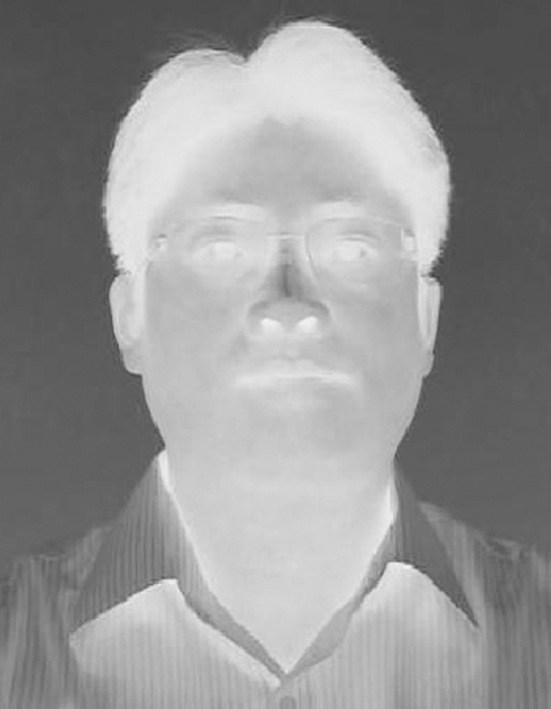

False False

Rotated OCR preview:
 4 s 7 —r - 

Original OCR preview:
 g s . \ 


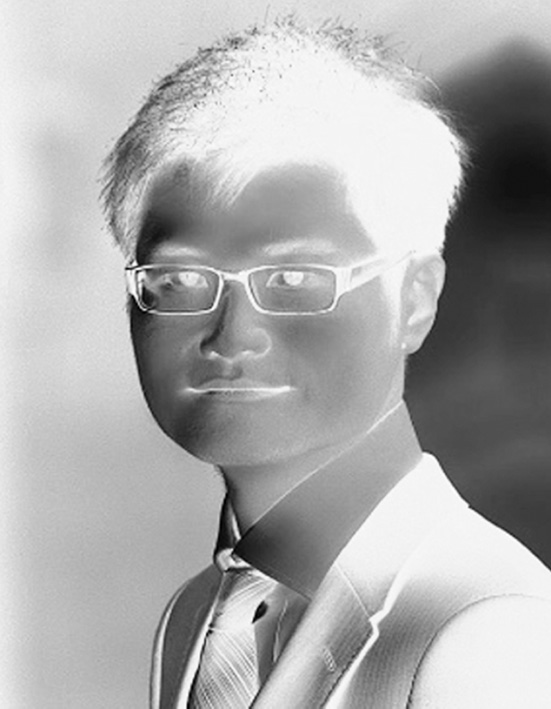

False False

Rotated OCR preview:
 —_ > ” . af ~ 4, = es 4 weg ™]! 

Original OCR preview:
 : e.- a a - = “e a ar . . ete in : > = yy _ a . ~ a \ ie : 7 ca pas a \ f: . y~ ' f z ‘ ‘“ e te et ” . \¥j 4 ° m | ec 


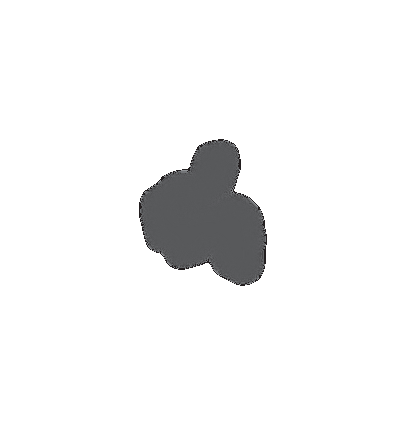

False False

Rotated OCR preview:
 > 

Original OCR preview:
 & 


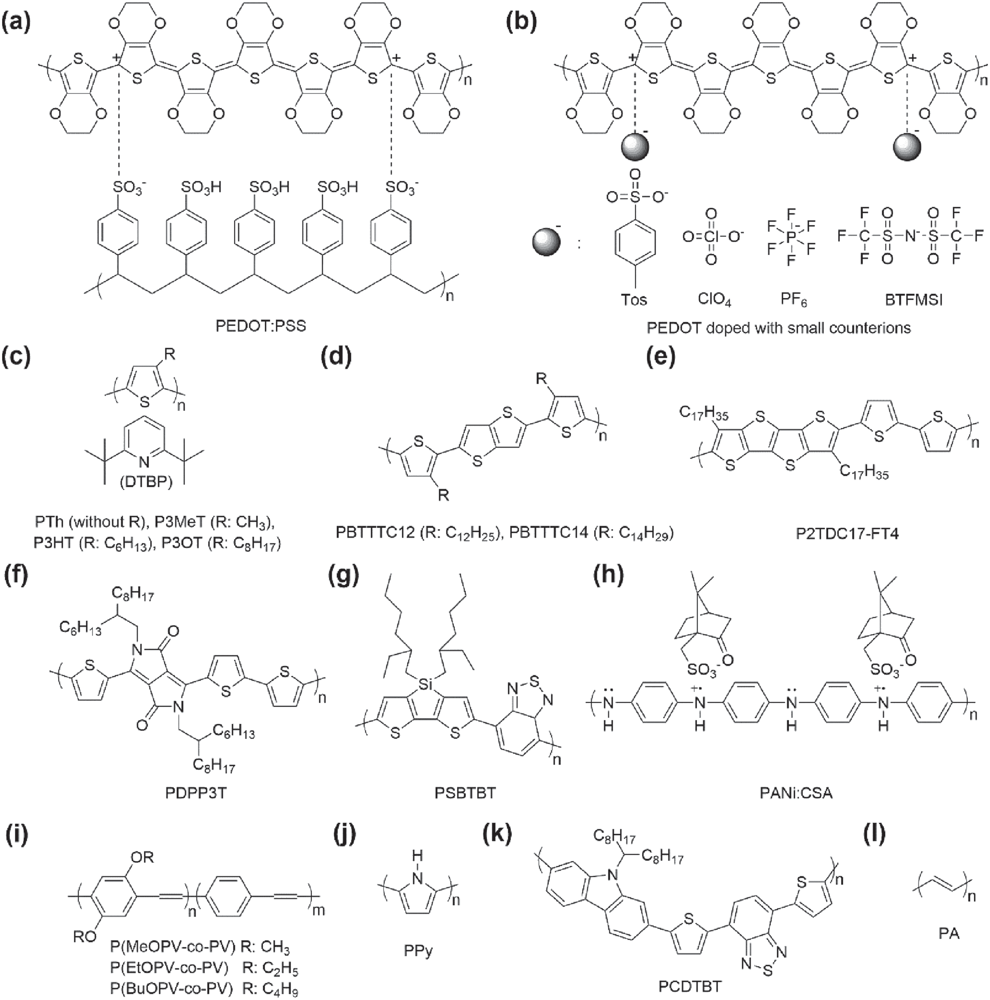

False False

Rotated OCR preview:
 aa, palin, — pain, = => az} 2 au o —) e) a a 2 ma ( a, o ~” _ a= — 22 ye fb opps ui x oo /— o b58 ° 3 oe 48 ss ( i» ww — la, ww am = § o s) ads a — o ” no | omen’. = 2 a o & n tft ~— “- _ ww sais or | on ~ by + j/ © oo a ~~ % o os of 5 _ wn, o) — ee = — r o oo | ) = — o () ------------- a (= " venn 

Original OCR preview:
 (a) oo oo 0 0 oo 0 (b} 0 oo oo oo 0 o s #7 \v s.-/ \i sl us s 4 \~ s/f \. sl us \ ff is _ s _ so; \ ffin \ f ws _ ss _ so: \ fin qo o-; oo oo one, :o oo o oo; oo 86°08 oo oo ‘oq oo so, so,h so3h so3h so, 7 3 3 3 3 3 o=s-o o f fo of - rt fli-f i ot a. o f fo of n tos clo, pf¢ btfmsi pedot:pss pedot d


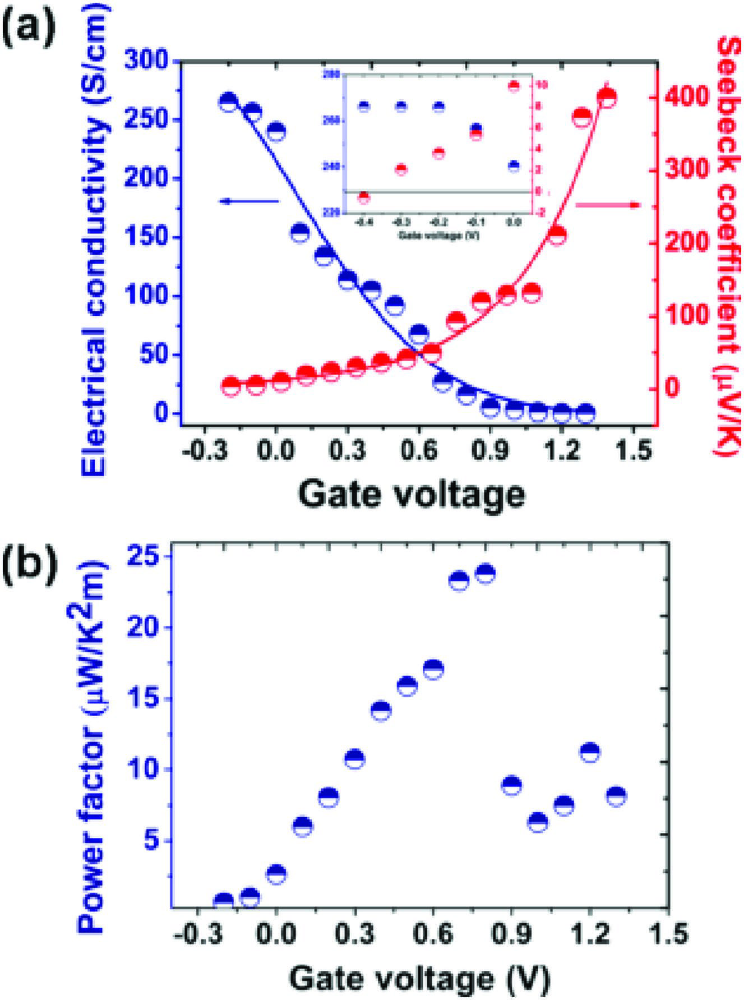

False False

Rotated OCR preview:
 ian sin, of ft al ‘gel power factor (uwik2m)} electrical conductivity (s/cm)} oo 4 8 of o 88 88 8 & & . 7 ofc d> 7, 'p ; =f to . , rae . = 2 ” |oa1.n foo o ° | ple wr ond {* , le ‘d i) ‘ . gs, » on _ ‘} ol. | - | x ‘o ‘b - ' (pm ea a wn “ es 8 $ 6 (wat) jubidiieos yyoaqeas 

Original OCR preview:
 (8) e soc a © at 450. —y | =.= «ss " '. af 400 = 3 a > nr s 200 s 100- ne (m }. &. e ae 100 ® < 03 00 03 06 09 12 15 2s gate voltage w 20 3 10 - ~ _ - 2 - a 6.3 00 03 o06 o9 12 1.5 gate voltage (v) 


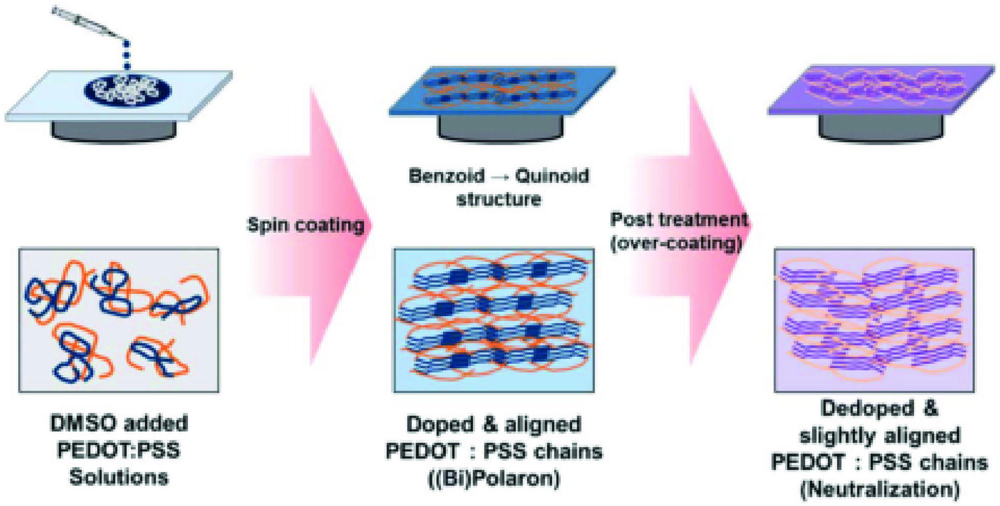

False False

Rotated OCR preview:
 m z op) wo py = 5 a ld 5 .“} meh fa i 5 re - | o = z oe \ ; | \w “y i a “= was a) eo 2» ee a ee — = ® . 4 iy t a! 1 | j j a hd ) i ey" a. wee yh | a 30 a he ci 

Original OCR preview:
 ra on, *, benzord - quinod structure — (over -coating) st et ay ee - a dmso added doped & aligned li ghtly a igned pedot:pss pedot : pss chains perot bes chains solutions ((bijpolaron) (neutralization! 


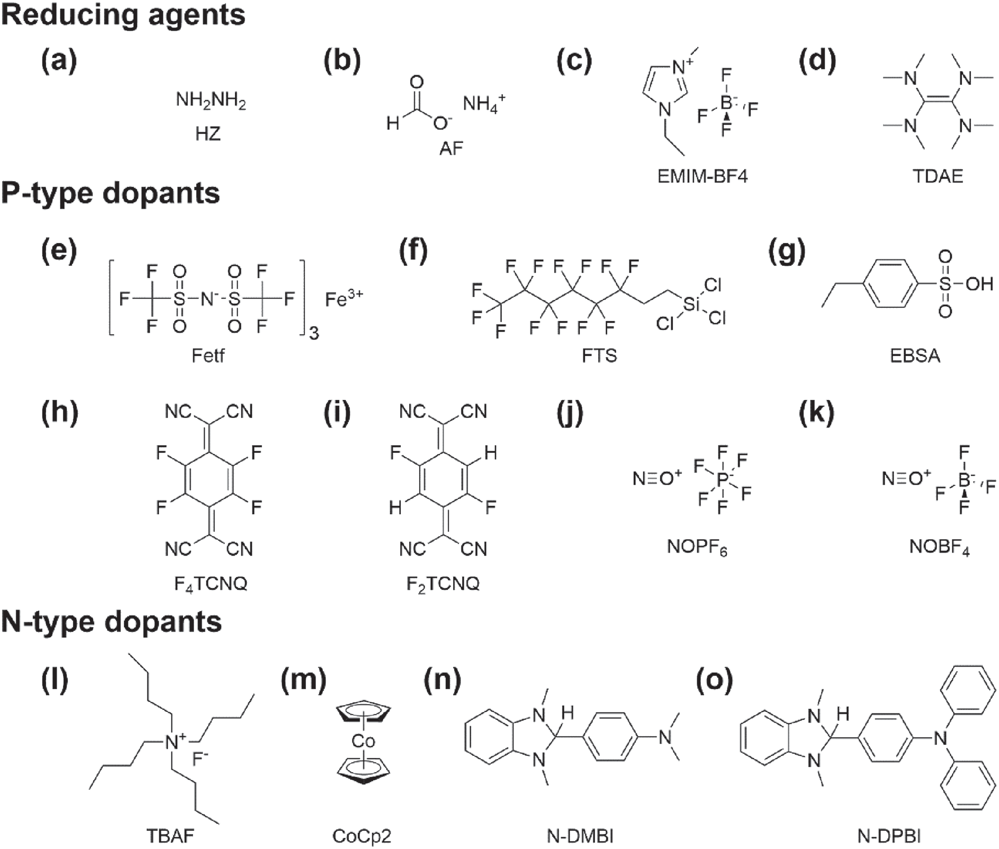

False False

Rotated OCR preview:
 l. vu aj = es o es 5 e § = 2 eee” o @ o. wan : | 3 . —| © m1 a) oo nn t > 4. es s o=0=0 «= > @ tl +t 4 __ wn > - x + @ o2) © — - " a n 2 = og s o=h=0 o “) nm mv m7 3 > © 5 = o ss 29 (ey n> t ti l z<. z< ei, ~ 59 o = y=0 => 3 -\_/- a c) c-) vp z z mm = ti tl 7 so ti > ae zo a tw oo r a. v1 a ry =< — 

Original OCR preview:
 reducing agents (a) (b) 5 (c) rs f (d) rae we loa ne n© p-bur = —n n— ii af lf a, p-type dopants emimrer tdae (e) (f) (9) 9 fo of f fr fr fef i fo of jz fie ffff cl © (fn) nc. ucn (1) nc. ucn (1) (k) ° ° r " ff ji n=o* ps n=o* _ bip ponto hon of repr yf nc” ~cn nc” ~cn nopf, nobf, f,tcnq f.tcnq n-ty


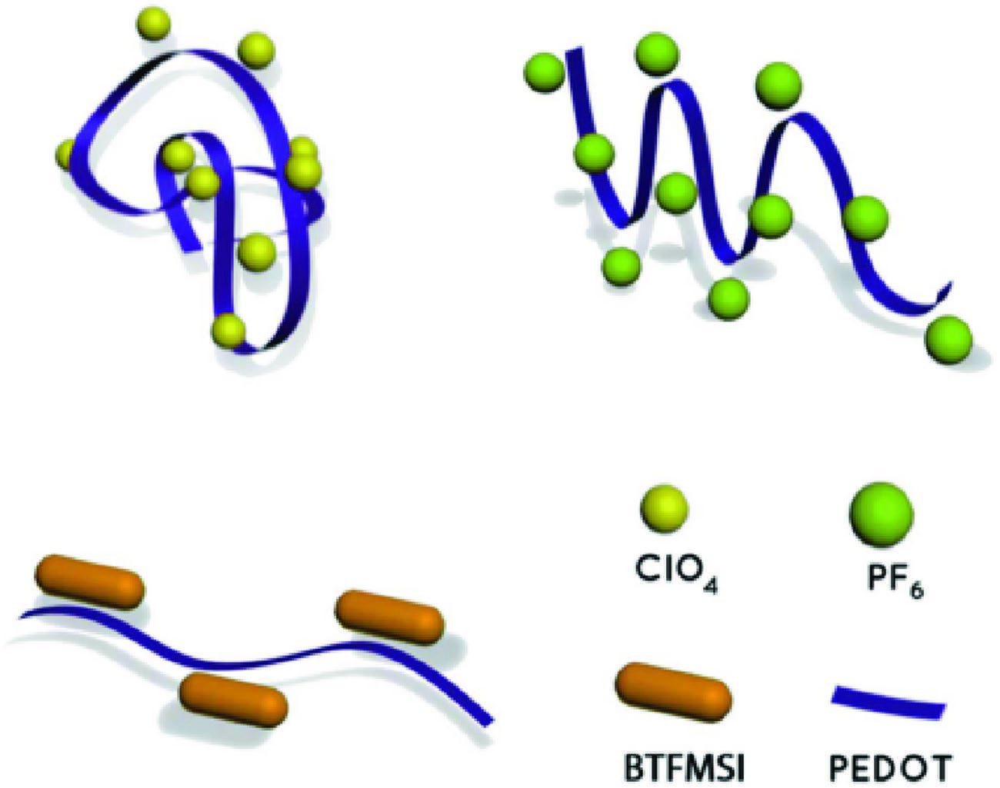

False False

Rotated OCR preview:
 g an h he , c = a c , cc 

Original OCR preview:
 cc 86 | cio, pf, as ap gs —. btfmsi pedot 


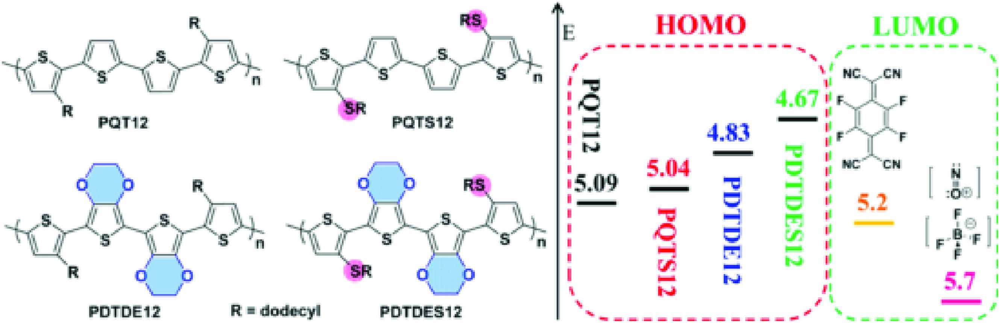

False False

Rotated OCR preview:
 | | -” = =f a wast aw " wg ee erst ~ - “wn | = roe - - i m _— ne i mes a tr | un . ] ‘= _ au | = af . 3: ee | =_ | wo o 722, ray | fl \. 7 | b - ol pi = i _t =, — o meet, ue - - i ° “ a b ‘_ az a ait | aaa st a | = tilod j rs ! ) ! . | i hy . | _ | eislod |s z : 4 1s } + , = | tiacllgd | 2e : , i . 

Original OCR preview:
 — — ny hoa 5 pee ee ee ee eee, 7 bo oa ub og a 4 ot ae ; i : : & if , i : r of | feet potiz2 pots? = fe le o.660 r ao oo ra, ih . fs bo oe a 8 a lb as a ee a es a = . 1 ms ‘n °. o” “4 we - z “ry 1 i ‘ tl "4 “ : . nn \ haan! = f b f — font a : ‘ i if tos f r o 66 a _ i , 5.7 __ , ‘ fad f 7 , ’ — fotd


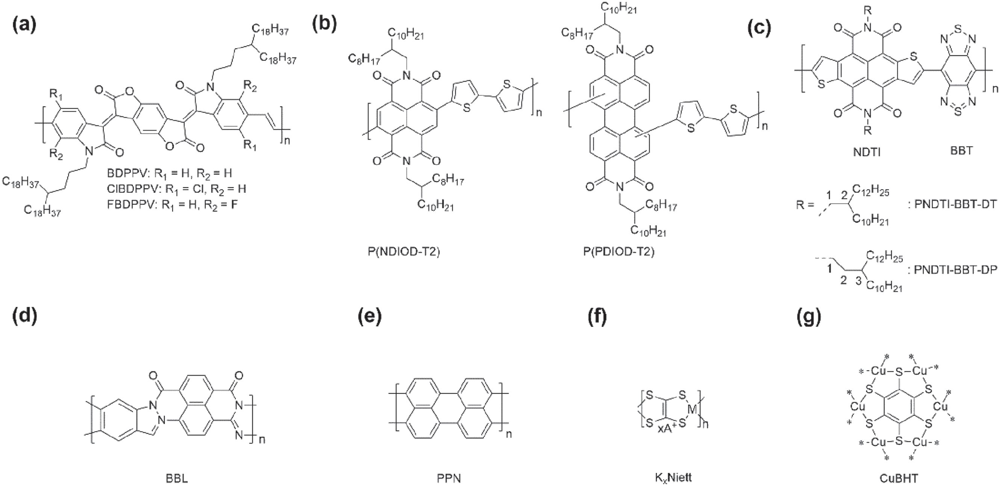

False False

Rotated OCR preview:
 ©) ein, oo ain, ©. ooo lt pf) a = nar all _—l 4 © bo3 gf \ ogu o uv u ute <- us z yu wo aa, o é toy x o nn irn: cs are 9° nm a tt < n™ — h zy 27 ©) 1 bas qo = con = = 5 x 3 ~j an, (oy we? £ i, — & x o or =< = ona. cs e ot xk) ° 5 © 3 no) co z - oo cts 7 s en > qc © 4) + a bs q — o-~ — uu = , pkl ye 

Original OCR preview:
 caghay r | o. .n. lo lf sw cty fj s s ¢ ) o. _n__o [> mi r, o_o ox ne jp \_a s n yy \! a ¢ nan pt \~7 (nv (cr s am 07 no : he ah c n ndti bbt r2 0 o”~n 0 a cat, i cibdppv: r, = cl,r>=h ~ al on ae) | crghos cig fbdppv: ry =h, ro=f ciphay ns re ' : pndti-bbt-dt capho, 10° '31 p(ndiod-t2) p(pdiod-t2) ;


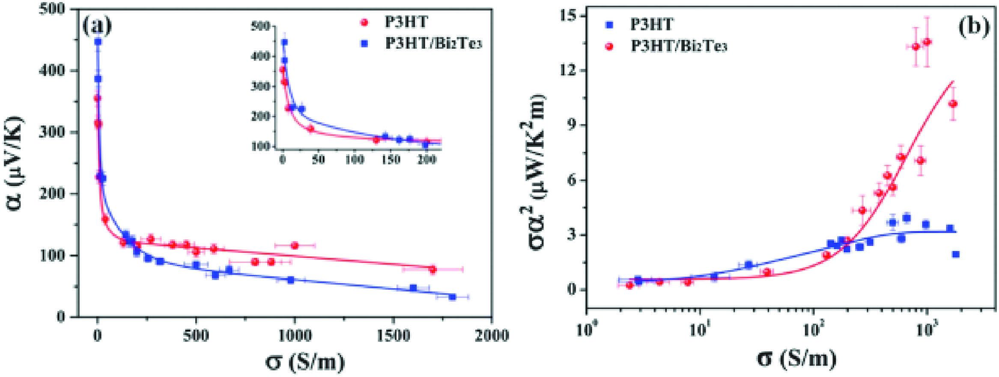

True True


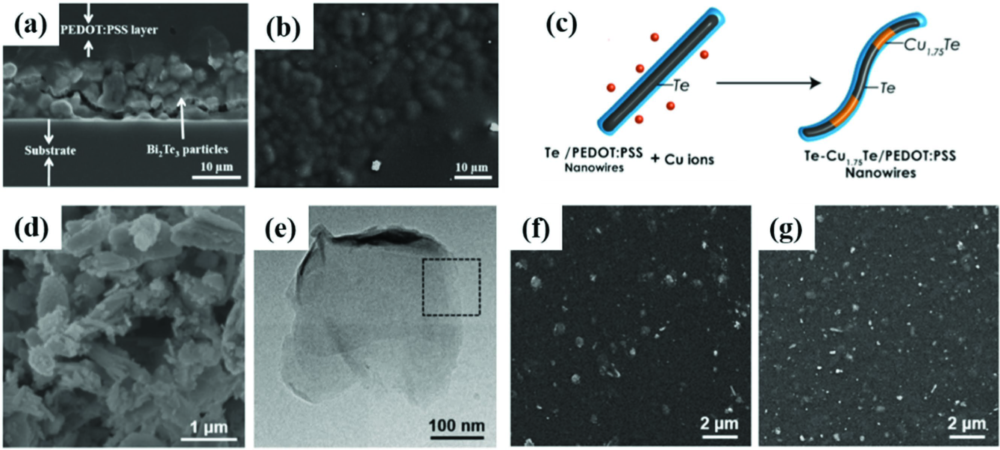

False False

Rotated OCR preview:
 a= | - — . mt a o < —w ~ : pe ‘ rm » | ) 4, | = : >= s. a 5 a = ~ f 4 c oe: - 3 f yo =} # . . a ae a a_ a a et ‘“ . ae r “. vo ’. | . a ug 6 ab “o£ a o /f ba | a > am =, | » ° - ~~ —_ ea’ 33 te) . o = © “ . ~” ~” © © 7m + rd) ’ ‘@) © c y 5 ro ; a 2 t » ox =| ° we " re > ,. . 7 . : . ang o ° ® ~ 2 , 

Original OCR preview:
 (a) pedoe:pss laver (b) (c) © | 1) cu, ,,je © » ! © ; | © le —~ te ™n a f " © ‘| - _ © _ 10 pm nanowires * cu tons fe eee ots (d) in. ge- -~ by (g) ete = soe 1 um 100 nm 2 ym y a , 2um 


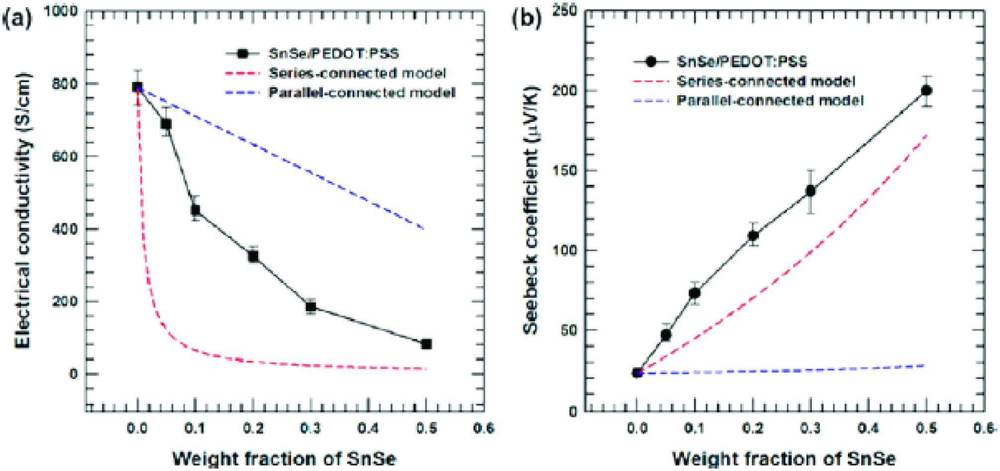

True False

Rotated OCR preview:
 x. electrical conductivity ($/cm) lod oh ss = 5 bas z | o os 5 o 3 teri op tra r pero ry rte tzyt tts | o | o le - ---- of ‘ — a ~ an 7 r oo ’ -— é 4 a / ‘ : j i 1 ! ! ot o i fo f ‘| ¢ _ =~ = | | of i 1 ot 4 pe ™ i / v wy ut " oo fa r = a fe f j be f ~, i f h 9 aa woof oo: of 38 + | oll i ° r ~ mf |

Original OCR preview:
 (a) 1000 trot ptutt pe ttr ptt ter ptt tty tr ry (b) 250 | ttt t mt) - cree connected moarndal snsepeoot: pss c ao | phen _~ | ---- sones-connected mode! mn | e - *- ~ — 77) paralial-connected modal _ 00 -~--. parallel.cannected model fos | —_ ben 7 ot ~) s | nl - | \ te = lo | - = | + = “or os © ss


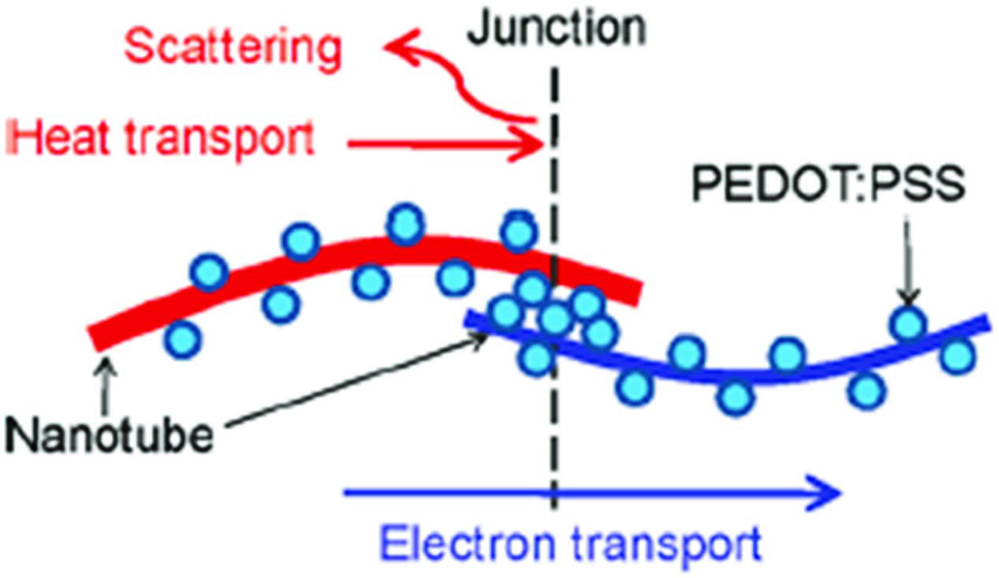

False False

Rotated OCR preview:
 z. ae — 4) q—> - c zt ym rox ® qo» —a @ @ a> os 3 o —_ ©. @ 4 os (© @ ‘an > 7 7 q @ = cq 9 0 e | s ; dy s = ®@ pa | @ s vu 2 . 5 ) o eo, yy) e y 

Original OCR preview:
 scattering ere heat transpon ————-» | | pedot:pss a) hee > | ® yy op ° e ot 0k — - { 2 one o eee nanotube ) ——> electron transport 


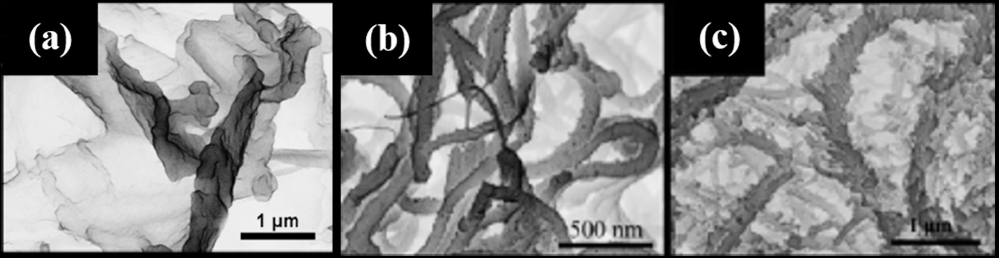

False False

Rotated OCR preview:
 - am pate .- a . rn ag , * %> a «ve me | nn 

Original OCR preview:
 @ (ey © ce om £* x : 1 <.. on 


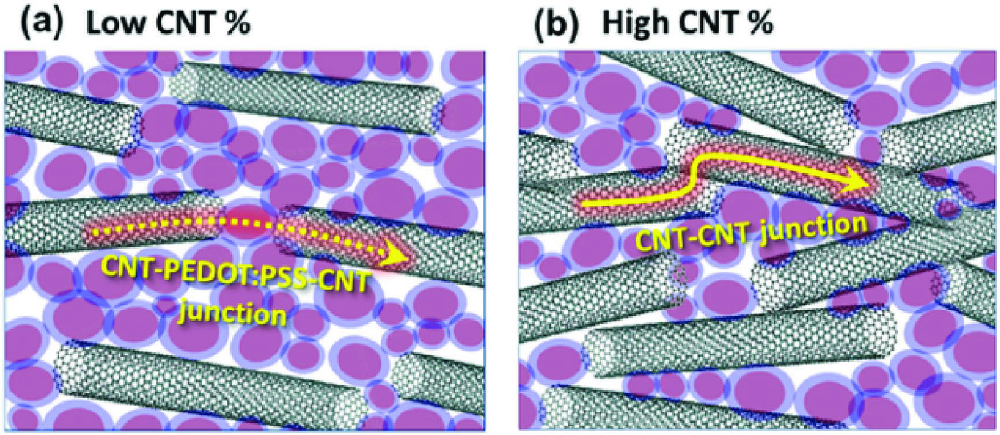

False False

Rotated OCR preview:
 rr 3! - se fs o> as we aa ra ah ere bans fits we \ oy irs chats | a ' eae -” rate rls ty a o fn, ra me: * . « " +f 7 j : a ry a m= of ° oie, mm 48 . %: eet a in le py ® sf on a - eas i i we a ee , mo ae 2 ee wo prey - & ! r=, _£ ‘meet a soe | pm. 7 ty . ‘y %, ‘eu, wniestn aaa! if . , ee eee eee res 

Original OCR preview:
 igh cnt % a) low cnt % (b) high cnt % (a) low cnt _ i lg »@ ; &. ‘ an 5 tey * rae “ ta ls che — f t hai’ wea bp yt \ eee! soe a ee md pe nr em ii es ; ps eat ae so aee pte chat as aa, hs ahd pe tt eee bhar | -pityt meee herr eevee ret — he see sn" < | m a 4% i 7 7 . fly. ; r o ' bh, we neaf = sor ee


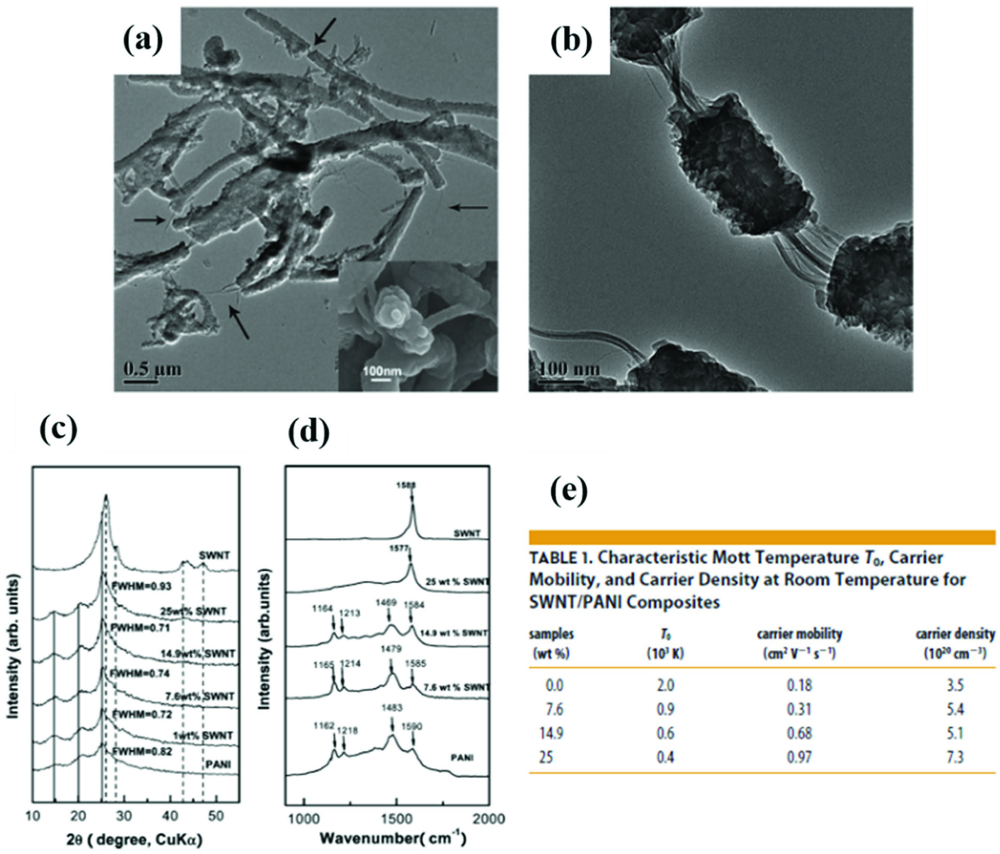

False True

Rotated OCR preview:
 intensity (arb. units) od oo ~ ' _ © zs ( px a . te n a ee, sa ae, a, pa , ‘ a ff a 4 | | a cs 8 . si~ | fa are e | = ~ ' ~~ aa ~~ ~-4..-|%..- a i one : pw y 4h ~ be 3 ; ” _ 3 pare .! , - : a , intensity (arb.units) ui “x (br 3 , —_ \ is ° ‘not . ” = es. 1 rs: ane. 8 fo ~ .¥. © \ . ly (4 ® * ; o < i

Original OCR preview:
 (2) (b) sead se we - sn an - ~~ . | nae wnty ~~ | 4 : ”. 5 . in ere sey ae a vo a re aire “ | (a a gg, ae .¢ a ° “” a \ . a r —_~ ., ~ r o-” e : \ ' sf oh (c) (d) __ | oe awe table 1. characteristic mott temperature jo, carrier ry ‘towmnons (‘|s mobility, and carrier density at room temperature for 


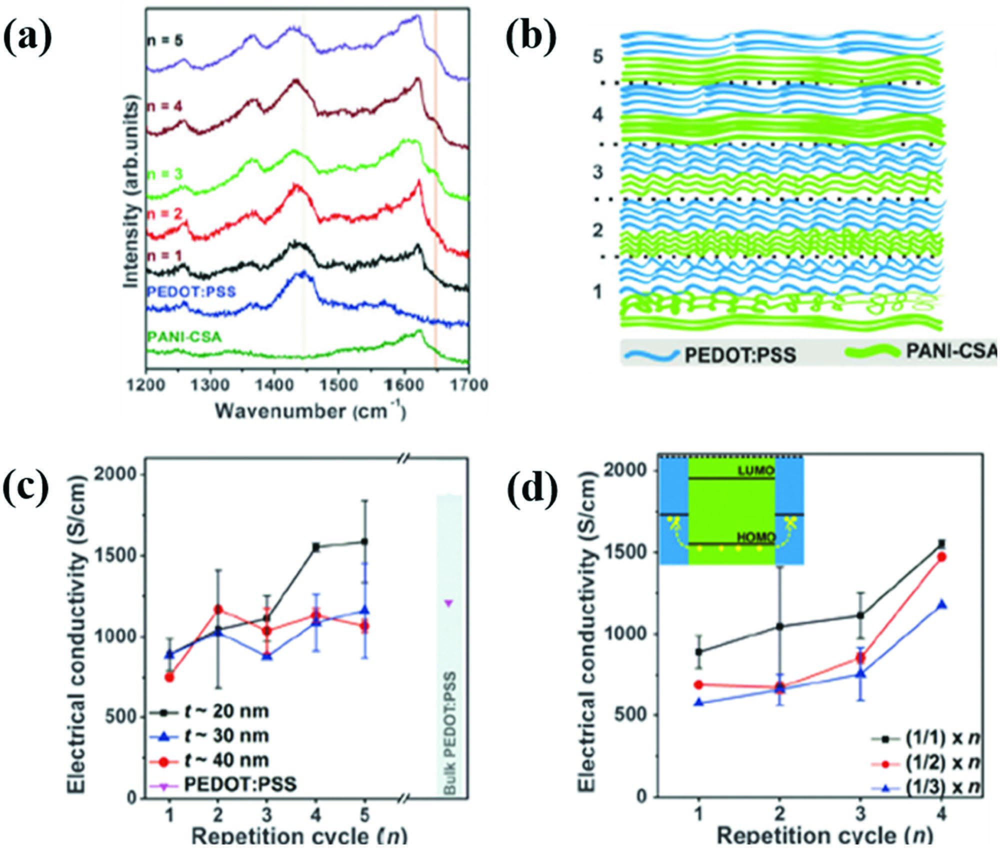

False False

Rotated OCR preview:
 co ‘ aaj = electrical conductivity (s/cm) -_ = do ra = ra ° ° = ° = © ~ intensity (arb.units) © ; ajo ef “liz ts o7 a] 22 pe rad m ! to wills f 5” o ss06 : 2° a oc jax 33 5 | e ; =] 0 333 sal! s| : 5 >]: qo > ~ zt | \ < i o w , o. | = 8|' ow - > re) ~ 3 . > —a) \ = § v ° © 2 s ‘ew’ eu’ electrical co

Original OCR preview:
 5 _ ~ _ —— 3 4c © lao] = 9 dra rrr rra c eeee,e e 8&8 gwees+eee @ @€ © © @ @ © @ e — peoot pss qt nmr or ror pam cea aan ee ee et —~—~ pedot:pss pani-csa 1200 1300 1400 1800 14600 1700 wavenumber (cm } _ 2000 — 2000 {fa pss fit (cc) & (d)=t ks o l = : > 1500 zp 1500 =a va = : = t oo - 4. 4 oo a > 10


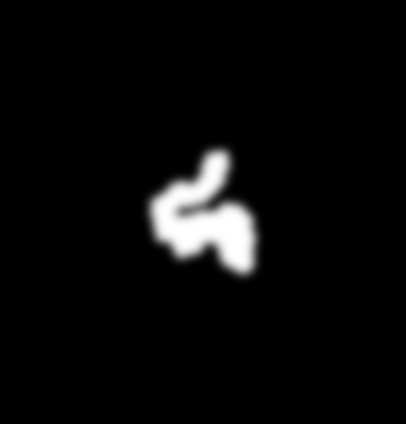

False False

Rotated OCR preview:
 ps 

Original OCR preview:
 


In [55]:
import fitz  # pip install pymupdf
import io
from PIL import Image
from IPython.display import display
#pdf_path = "PDFs_to_parse/GDOS_UMASS_Nature Comm_2019.pdf"
pdf_path = "Macromolecular Rapid Communications - 2018 - Yao - Recent Development of Thermoelectric Polymers and Composites.pdf"
doc = fitz.open(pdf_path)


lenXREF = doc.xref_length()

for xref in range(1, lenXREF):
    obj = doc.xref_get_key(xref, "Subtype")

    if obj[1] == "/Image":
        imgdata = doc.extract_image(xref)
        img_bytes = imgdata["image"]
        
        temp_path = save_image_to_temp_path(img_bytes)
        
        pil_image = Image.open(temp_path)
        
        display(pil_image)   # notebook
        result = check_axes(temp_path)
        print(result["y_match"], result["x_match"])
        if(result["y_match"]==True & result["x_match"]==True):
            #Save these
            continue
        
        print("\nRotated OCR preview:\n", result["rotated_ocr_preview"])
        print("\nOriginal OCR preview:\n", result["original_ocr_preview"])

Core Concepts of RAG
The RAG pipeline works by combining a retrieval mechanism with the LLM’s generative capabilities through the following stages:

1. Indexing (Data Preparation)
    - External Knowledge Source: Relevant documents, PDFs, databases, or web pages are gathered into a knowledge base.
    - Chunking: Large documents are split into smaller, manageable chunks of text so that the most relevant segments can be efficiently identified.
    - Embedding: An embedding model converts these text chunks into numerical representations called vectors. These vectors capture the semantic meaning of the text and are stored in a vector database.

2. Retrieval
When a user submits a query, the query is also converted into a vector. A search algorithm performs a similarity search within the vector database to find the top-ranked chunks that are most relevant to the query’s meaning.

3. Augmentation
The retrieved text chunks are added to the original user query, creating an augmented prompt.This provides the LLM with specific, context-aware information.

4. Generation
The augmented prompt is sent to the Large Language Model (LLM). The LLM uses its inherent knowledge, combined with the newly provided context, to generate a precise, factually grounded, and human-like answer.

In [67]:
# Main Logic is here

import os
import time
import fitz
import tkinter as tk
from PIL import Image, ImageTk

# ---------------- CONFIG ----------------
PDF_PATH = r"PDFs_to_parse/GDOS_UMASS_Nature Comm_2019.pdf"     # <-- put your PDF path here
OUTPUT_FOLDER =  r"research\snips" # <-- put your output folder here
ZOOM = 2.5
# ----------------------------------------


class PdfSnipSingle:
    def __init__(self, pdf_path, output_folder, zoom=2.5):
        self.pdf_path = pdf_path
        self.output_folder = output_folder
        self.zoom = zoom

        self.page_idx = 0
        self.doc = fitz.open(pdf_path)

        self.root = tk.Tk()
        self.root.title(os.path.basename(pdf_path))

        # --- top bar
        bar = tk.Frame(self.root)
        bar.pack(fill=tk.X)

        tk.Button(bar, text="Prev Page", command=self.prev_page).pack(side=tk.LEFT, padx=4, pady=4)
        tk.Button(bar, text="Next Page", command=self.next_page).pack(side=tk.LEFT, padx=4, pady=4)
        tk.Button(bar, text="Save Snip", command=self.save).pack(side=tk.LEFT, padx=4, pady=4)

        self.page_label = tk.Label(bar, text="", anchor="w")
        self.page_label.pack(side=tk.LEFT, padx=12)

        # --- canvas area with scrollbars
        canvas_frame = tk.Frame(self.root)
        canvas_frame.pack(fill=tk.BOTH, expand=True)

        self.vbar = tk.Scrollbar(canvas_frame, orient=tk.VERTICAL)
        self.hbar = tk.Scrollbar(canvas_frame, orient=tk.HORIZONTAL)

        self.canvas = tk.Canvas(
            canvas_frame,
            bg="black",
            yscrollcommand=self.vbar.set,
            xscrollcommand=self.hbar.set
        )

        self.vbar.config(command=self.canvas.yview)
        self.hbar.config(command=self.canvas.xview)

        self.vbar.pack(side=tk.RIGHT, fill=tk.Y)
        self.hbar.pack(side=tk.BOTTOM, fill=tk.X)
        self.canvas.pack(side=tk.LEFT, fill=tk.BOTH, expand=True)

        # selection rectangle state
        self.rect = None
        self.start_xy = None
        self.box = None

        # mouse bindings for snip
        self.canvas.bind("<Button-1>", self.start)
        self.canvas.bind("<B1-Motion>", self.drag)
        self.canvas.bind("<ButtonRelease-1>", self.end)

        # mouse wheel scrolling (Windows/macOS/Linux variants)
        self.canvas.bind_all("<MouseWheel>", self._on_mousewheel)        # Windows/macOS
        self.canvas.bind_all("<Shift-MouseWheel>", self._on_shiftwheel)  # horizontal on shift
        self.canvas.bind_all("<Button-4>", self._on_linux_up)            # Linux up
        self.canvas.bind_all("<Button-5>", self._on_linux_down)          # Linux down

        self.render()
        self.root.mainloop()

    def render(self):
        page = self.doc.load_page(self.page_idx)
        pix = page.get_pixmap(matrix=fitz.Matrix(self.zoom, self.zoom))
        img = Image.frombytes("RGB", (pix.width, pix.height), pix.samples)

        self.img = img
        self.tkimg = ImageTk.PhotoImage(img)

        self.canvas.delete("all")
        self.canvas.create_image(0, 0, image=self.tkimg, anchor="nw")

        # make canvas scrollable over full image
        self.canvas.config(scrollregion=(0, 0, img.width, img.height))

        # reset view to top-left when changing pages
        self.canvas.xview_moveto(0)
        self.canvas.yview_moveto(0)

        # update page label
        self.page_label.config(text=f"Page {self.page_idx + 1} / {len(self.doc)}")

        # clear previous selection
        self.box = None
        self.rect = None
        self.start_xy = None

    # ---------- snip logic (account for scrolling) ----------
    def start(self, e):
        # convert screen coords to canvas coords (important when scrolled)
        x = self.canvas.canvasx(e.x)
        y = self.canvas.canvasy(e.y)
        self.start_xy = (x, y)
        if self.rect:
            self.canvas.delete(self.rect)
        self.rect = self.canvas.create_rectangle(x, y, x, y, outline="yellow", width=2)

    def drag(self, e):
        if not self.rect or not self.start_xy:
            return
        x = self.canvas.canvasx(e.x)
        y = self.canvas.canvasy(e.y)
        self.canvas.coords(self.rect, self.start_xy[0], self.start_xy[1], x, y)

    def end(self, e):
        if not self.start_xy:
            return
        x0, y0 = self.start_xy
        x1 = self.canvas.canvasx(e.x)
        y1 = self.canvas.canvasy(e.y)
        self.box = (min(x0, x1), min(y0, y1), max(x0, x1), max(y0, y1))

    def save(self):
        if not self.box:
            print("No snip selected.")
            return

        os.makedirs(self.output_folder, exist_ok=True)

        # crop expects ints
        x0, y0, x1, y1 = map(int, self.box)
        crop = self.img.crop((x0, y0, x1, y1))

        base = os.path.splitext(os.path.basename(self.pdf_path))[0]
        name = f"{base}_p{self.page_idx+1}_{int(time.time())}.png"
        out_path = os.path.join(self.output_folder, name)
        crop.save(out_path)

        print("Saved:", out_path)

    # ---------- page nav ----------
    def prev_page(self):
        self.page_idx = max(0, self.page_idx - 1)
        self.render()

    def next_page(self):
        self.page_idx = min(len(self.doc) - 1, self.page_idx + 1)
        self.render()

    # ---------- scrolling ----------
    def _on_mousewheel(self, event):
        # Windows: event.delta is +/-120 per notch, macOS differs but this still works okay
        self.canvas.yview_scroll(int(-1 * (event.delta / 120)), "units")

    def _on_shiftwheel(self, event):
        self.canvas.xview_scroll(int(-1 * (event.delta / 120)), "units")

    def _on_linux_up(self, event):
        self.canvas.yview_scroll(-1, "units")

    def _on_linux_down(self, event):
        self.canvas.yview_scroll(1, "units")


PdfSnipSingle(PDF_PATH, OUTPUT_FOLDER, zoom=ZOOM)


Saved: research\snips\GDOS_UMASS_Nature Comm_2019_p5_1767270832.png


In [72]:
#{'polymer': 'PDPP4T', 'film preparation method': None, 'dopant': None, 'doping method': None, 'solvent': None,'characterisation': None, 'evidence': []}]}

import re
import json
import fitz

# 1) Put your direct PDF path here
PDF_PATH = r"PDFs_to_parse/GDOS_UMASS_Nature Comm_2019.pdf"
# or on Windows, something like:
# PDF_PATH = r"C:\Users\you\Downloads\paper.pdf"

# 2) If you already know the polymers from the figure legend, list them here
POLYMERS_FROM_LEGEND = ["P3HT doped at 25 °C", "P3HT doped at 75 °C", "PDPP4T doped at 25 °C", "PDPP4T doped at 75 °C"]  # edit based on legend text

# Optional: common solvents and dopants you care about (extend anytime)
SOLVENTS = [
    "DMSO", "DMF", "methanol", "ethanol", "water", "formic acid", "ethylene glycol", "EG",
    "acetone", "acetonitrile", "chloroform", "chlorobenzene", "o-dichlorobenzene",
    "tetrahydrofuran", "THF", "toluene", "isopropanol", "IPA"
]

DOPANTS = [
    "FeCl3", "F4TCNQ", "F2TCNQ", "FTS", "EBSA", "TFSI", "Tos", "PF6", "ClO4",
    "NOBF4", "NOPF6", "NaBH4", "HI", "HZ", "hydrazine", "EMIM-BF4", "ZnCl2"
]

DOPING_METHOD_HINTS = [
    "vapor doping", "immerse doping", "drop doping", "spin-coating doping",
    "posttreatment", "post treatment", "electrochemical", "chemical dedoping",
    "secondary doping", "treated with", "doped with", "added with"
]

FILM_PREP_HINTS = [
    "spin coating", "spin-coating", "drop casting", "drop-casting", "casting",
    "solution processing", "solution-processed", "electrochemical polymerization",
    "chemical polymerization", "vapor", "anneal", "stretched", "mechanical stretching"
]


def pdf_to_text(pdf_path: str) -> str:
    doc = fitz.open(pdf_path)
    chunks = []
    for i in range(len(doc)):
        t = doc[i].get_text("text")
        if t:
            chunks.append(t)
    doc.close()
    return "\n".join(chunks)


def split_sentences(text: str):
    # simple sentence splitter that works well enough for heuristics
    parts = re.split(r"(?<=[\.\?\!])\s+", text.replace("\n", " "))
    return [p.strip() for p in parts if len(p.strip()) > 0]


def first_match(patterns, text, flags=re.IGNORECASE):
    for pat in patterns:
        m = re.search(pat, text, flags)
        if m:
            return m.group(0)
    return None


def find_best_sentences(sentences, polymer, max_sent=2):
    # grab up to 2 sentences that mention the polymer and look “methods-ish”
    hits = []
    p = re.compile(rf"\b{re.escape(polymer)}\b", re.IGNORECASE)
    for s in sentences:
        if p.search(s):
            score = 0
            score += 3 if re.search(r"dop", s, re.IGNORECASE) else 0
            score += 2 if any(k.lower() in s.lower() for k in DOPING_METHOD_HINTS) else 0
            score += 2 if any(k.lower() in s.lower() for k in FILM_PREP_HINTS) else 0
            score += 1 if any(k.lower() in s.lower() for k in SOLVENTS) else 0
            score += 1 if any(k.lower() in s.lower() for k in DOPANTS) else 0
            hits.append((score, s))
    hits.sort(key=lambda x: x[0], reverse=True)
    return [s for _, s in hits[:max_sent]]


def extract_fields_from_text(text: str, polymer: str):
    sentences = split_sentences(text)
    evidence = find_best_sentences(sentences, polymer, max_sent=2)

    evidence_blob = " ".join(evidence)

    # Dopant: try a “doped with X” pattern first, then fall back to dictionary scan
    dopant = None
    m = re.search(r"dop(?:ed|ing)\s+(?:with|by)\s+([A-Za-z0-9\-\(\)]+)", evidence_blob, re.IGNORECASE)
    if m:
        dopant = m.group(1)
    else:
        for d in DOPANTS:
            if re.search(rf"\b{re.escape(d)}\b", evidence_blob, re.IGNORECASE):
                dopant = d
                break

    # Doping method: choose the first hint that appears
    doping_method = None
    for k in DOPING_METHOD_HINTS:
        if k.lower() in evidence_blob.lower():
            doping_method = k
            break

    # Solvent: pick first solvent keyword seen
    solvent = None
    for s in SOLVENTS:
        if re.search(rf"\b{re.escape(s)}\b", evidence_blob, re.IGNORECASE):
            solvent = s
            break

    # Film preparation method: pick first prep keyword seen
    film_prep = None
    for k in FILM_PREP_HINTS:
        if k.lower() in evidence_blob.lower():
            film_prep = k
            break

    # Characterisation: keep it 1–2 sentences, purely heuristic
    characterisation = " ".join(evidence) if evidence else None

    return {
        "polymer": polymer,
        "film preparation method": film_prep,
        "dopant": dopant,
        "doping method": doping_method,
        "solvent": solvent,
        "characterisation": characterisation,
        "evidence": evidence
    }


def build_json_from_polymers(pdf_path: str, polymers: list):
    text = pdf_to_text(pdf_path)
    out = {
        "source pdf": pdf_path,
        "entries": []
    }
    for p in polymers:
        out["entries"].append(extract_fields_from_text(text, p))
    return out


data = build_json_from_polymers(PDF_PATH, POLYMERS_FROM_LEGEND)

# save
with open("polymer_metadata.json", "w", encoding="utf-8") as f:
    json.dump(data, f, indent=2, ensure_ascii=False)

data


{'source pdf': 'PDFs_to_parse/GDOS_UMASS_Nature Comm_2019.pdf',
 'entries': [{'polymer': 'P3HT doped at 25 °C',
   'film preparation method': None,
   'dopant': None,
   'doping method': None,
   'solvent': None,
   'characterisation': 'P3HT ﬁlms doped at 75 °C showed a marginally narrower distribution of SPCs, suggesting that P3HT ﬁlms doped at 75 °C exhibit a slightly more homogeneous distribution of iodine-doped states compared to P3HT doped at 25 °C. σ trends with heterogeneous spatial distributions of dopants throughout the sample using surface potential contrast (SPC) mapping by Kelvin probe force microscopy (KPFM), which a 1.6 V 1 0.5 –0.1 –0.1 Probability (normalized, offset) –0.1 –0.1 –0.1 0.0 0.2 0.4 1.4 SPC (V) 1.6 1.8 2.0 0.5 0.5 0.5 0.5 Pristine P3HT Pristine PDPP4TT P3HT doped at 25 °C P3HT doped at 75 °C PDPP4T doped at 25 °C PDPP4T doped at 75 °C b c d e f Fig.',
   'evidence': ['P3HT ﬁlms doped at 75 °C showed a marginally narrower distribution of SPCs, suggesting that

## Implementing a RAG System

# ORGINAL FROM VIDEO 
# =========================
# 1) INGESTING PDF
# =========================

!pip install -q unstructured langchain
!pip install "unstructured[all-docs]"

from langchain_community.document_loaders import UnstructuredPDFLoader
from langchain_community.document_loaders import OnlinePDFLoader

local_path = "WEF_The_Global_Cooperation_Barometer_2024.pdf"

# Local PDF file uploads
if local_path:
    loader = UnstructuredPDFLoader(file_path=local_path)
    data = loader.load()
else:
    print("Upload a PDF file")

# Preview first page
data[0].page_content


# =========================
# 2) VECTOR EMBEDDINGS
# =========================

# Pull the embedding model with Ollama
!ollama pull nomic-embed-text

# List available Ollama models
!ollama list

# Install required packages
!pip install -q chromadb
!pip install -q langchain-text-splitters

from langchain_community.embeddings import OllamaEmbeddings
from langchain_text_splitters import RecursiveCharacterTextSplitter
from langchain_community.vectorstores import Chroma

# Split and chunk
text_splitter = RecursiveCharacterTextSplitter(chunk_size=7500, chunk_overlap=100)
chunks = text_splitter.split_documents(data)

# Add to vector database
vector_db = Chroma.from_documents(
    documents=chunks,
    embedding=OllamaEmbeddings(model="nomic-embed-text", show_progress=True),
    collection_name="local-rag"
)


# =========================
# 3) RETRIEVAL (RAG)
# =========================

from langchain.prompts import ChatPromptTemplate, PromptTemplate
from langchain_core.output_parsers import StrOutputParser
from langchain_community.chat_models import ChatOllama
from langchain_core.runnables import RunnablePassthrough
from langchain.retrievers.multi_query import MultiQueryRetriever

# LLM from Ollama
local_model = "mistral"
llm = ChatOllama(model=local_model)

QUERY_PROMPT = PromptTemplate(
    input_variables=["question"],
    template="""
You are an AI language model assistant. Your task is to generate five
different versions of the given user question to retrieve relevant documents
from a vector database. By generating multiple perspectives on the user question,
your goal is to help the user overcome some of the limitations of the
distance-based similarity search.

Provide these alternative questions separated by newlines.
Original question: {question}
"""
)

retriever = MultiQueryRetriever.from_llm(
    vector_db.as_retriever(),
    llm,
    prompt=QUERY_PROMPT
)

# RAG prompt
template = """
Answer the question based ONLY on the following context:
{context}

Question: {question}
"""
prompt = ChatPromptTemplate.from_template(template)

# Build RAG chain
chain = (
    {"context": retriever, "question": RunnablePassthrough()}
    | prompt
    | llm
    | StrOutputParser()
)

# Run query
chain.invoke(input(""))

# Optional: Delete the collection (clears db collection for this run)
# vector_db.delete_collection()


In [2]:
# =========================
# 1) INGESTING PDF
# =========================
!pip install -U langchain langchain-community langchain-core

!pip install -q unstructured langchain
!pip install "unstructured[all-docs]"

from langchain_community.document_loaders import UnstructuredPDFLoader
from langchain_community.document_loaders import OnlinePDFLoader

local_path = "PDFs_to_parse/Charge-Transport Model for conducting polymers.pdf"

# Local PDF file uploads
if local_path:
    loader = UnstructuredPDFLoader(file_path=local_path)
    data = loader.load()
else:
    print("Upload a PDF file")

# Preview first page
data[0].page_content

import langchain_community
print(langchain_community.__version__)



Defaulting to user installation because normal site-packages is not writeable
  Using cached requests-2.32.5-py3-none-any.whl.metadata (4.9 kB)
   ---------------------------------------- 0.0/2.5 MB ? eta -:--:--
   ---------------------------------------- 0.0/2.5 MB ? eta -:--:--
   ---- ----------------------------------- 0.3/2.5 MB ? eta -:--:--
   ---------------- ----------------------- 1.0/2.5 MB 3.5 MB/s eta 0:00:01
   ---------------------------------------- 2.5/2.5 MB 5.7 MB/s  0:00:00
   ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
   ---------------------------------------- 1.0/1.0 MB 26.2 MB/s  0:00:00
Using cached requests-2.32.5-py3-none-any.whl (64 kB)

  Attempting uninstall: requests

    Found existing installation: requests 2.32.4

    Uninstalling requests-2.32.4:

      Successfully uninstalled requests-2.32.4

   ---------------------------------------- 0/6 [requests]
   ------ --------------------------------- 1/6 [httpx-sse]
   -------------

C:\Users\kasif\AppData\Roaming\Python\Python313\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


0.4.1


In [26]:
# =========================
# 2) VECTOR EMBEDDINGS
# =========================

# Pull the embedding model with Ollama
!ollama pull nomic-embed-text

# List available Ollama models
!ollama list

# Install required packages
!pip install -q chromadb
!pip install -q langchain-text-splitters

from langchain_community.embeddings import OllamaEmbeddings
from langchain_text_splitters import RecursiveCharacterTextSplitter
from langchain_community.vectorstores import Chroma

# Split and chunk
text_splitter = RecursiveCharacterTextSplitter(chunk_size=7500, chunk_overlap=100)
chunks = text_splitter.split_documents(data)

# Add to vector database
vector_db = Chroma.from_documents(
    documents=chunks,
    embedding=OllamaEmbeddings(model="nomic-embed-text", show_progress=True),
    collection_name="local-rag"
)

pulling manifest â ‹ pulling manifest â ™ pulling manifest â ¹ pulling manifest â ¸ pulling manifest â ¼ pulling manifest â ´ pulling manifest â ¦ pulling manifest â § pulling manifest â ‡ pulling manifest â � pulling manifest â ‹ pulling manifest 
pulling 970aa74c0a90... 100% â–•â–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–� 274 MB                         
pulling c71d239df917... 100% â–•â–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–�  11 KB                         
pulling ce4a164fc046... 100% â–•â–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–�   17 B                         
pulling 31df23ea7daa... 100% â–•â–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–ˆâ–�  420 B                         
verifying sha256 digest 
writing manifest 
success 


NAME                       ID              SIZE      MODIFIED               
nomic-embed-text:latest    0a109f422b47    274 MB    Less than a second ago    
llama3.2:1b                baf6a787fdff    1.3 GB    58 seconds ago            
mistral:latest             f974a74358d6    4.1 GB    11 months ago             


OllamaEmbeddings: 100%|██████████████████████████████████████| 6/6 [00:21<00:00,  3.52s/it]


In [6]:
!pip install -U langchain-core langchain-community langchain-ollama


Defaulting to user installation because normal site-packages is not writeable

   -------------------- ------------------- 1/2 [langchain-ollama]
   ---------------------------------------- 2/2 [langchain-ollama]



In [10]:
!pip install -U langchain


Defaulting to user installation because normal site-packages is not writeable


In [23]:
!ollama pull llama3.2:1b


pulling manifest â ‹ pulling manifest â ™ pulling manifest â ¹ pulling manifest â ¸ pulling manifest â ¼ pulling manifest â ´ pulling manifest â ¦ pulling manifest â § pulling manifest â ‡ pulling manifest â � pulling manifest â ‹ pulling manifest â ™ pulling manifest â ¹ pulling manifest â ¸ pulling manifest â ¼ pulling manifest â ´ pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•                â–�    0 B/1.3 GB                  pulling manifest 
pulling 74701a8c35f6...   0% â–•        

In [24]:
!ollama list

NAME                       ID              SIZE      MODIFIED               
llama3.2:1b                baf6a787fdff    1.3 GB    Less than a second ago    
nomic-embed-text:latest    0a109f422b47    274 MB    8 minutes ago             
mistral:latest             f974a74358d6    4.1 GB    11 months ago             


In [27]:
from langchain_core.prompts import ChatPromptTemplate
from langchain_core.output_parsers import StrOutputParser
from langchain_core.runnables import RunnablePassthrough
from langchain_ollama import ChatOllama

# LLM
llm = ChatOllama(model="llama3.2:1b", temperature=0)

# Simple retriever (no MultiQueryRetriever)
retriever = vector_db.as_retriever(search_kwargs={"k": 6})

# RAG prompt
template = """
Answer the question based ONLY on the following context:
{context}

Question: {question}
"""
prompt = ChatPromptTemplate.from_template(template)

# Build chain
chain = (
    {"context": retriever, "question": RunnablePassthrough()}
    | prompt
    | llm
    | StrOutputParser()
)

# Run query
print(chain.invoke("""
Extract a structured record for polymer P3HT (if present) with these fields:
- polymer_name
- dopant_name(s)
- doping_method(s)
- solvent(s)
- film_preparation_method(s)

Return 'not stated in this paper' if a field is missing.
"""))


OllamaEmbeddings: 100%|██████████████████████████████████████| 1/1 [00:02<00:00,  2.11s/it]


Here's the extracted structured record for P3HT:

- polymer_name: P3HT
- dopant_name(s): None
- doping_method(s): None
- solvent(s): Tetrafluoroethylene (TFE)
- film_preparation_method(s): Solution-casting


In [ ]:
vector_db.delete_collection() # NOT SURE DONT PRESS YET

# ============New approach [14/01/2026]============

1. TEXT -> polymer, solvent, dopant, doping method, doping level, film preparation method, thickness, annealing, temperature, reference (DOI), evidence location

2. Figures -> σ, S

3. Gold Set -> PDFS_to_parse ~ Silver Set -> Yet to be created

# Research Groups
1) Linköping University, Laboratory of Organic Electronics (Crispin, Berggren)

Strong anchor for conducting-polymer thermoelectrics (PEDOT-family, optimization strategies).
Query: ("Xavier Crispin" OR "Magnus Berggren") (thermoelectric OR Seebeck) (PEDOT OR "conducting polymer") 
[Total 3 Papers Collected]

2) UCSB, Segalman Group (Rachel A. Segalman)

Major hub for organic thermoelectrics (structure–processing–property, includes n-type directions).
Query: ("Rachel Segalman" OR "R A Segalman") ("organic thermoelectric" OR Seebeck OR "power factor") polymer 
[Total 1 Papers Collected]

3) UCSB, Chabinyc Group (Michael L. Chabinyc)

Excellent for doping-method diversity (solution vs vapor/sequential) and morphology-controlled power factor.
Query: ("Michael Chabinyc" OR Chabinyc) (thermoelectric OR Seebeck OR "power factor") (vapor doping OR "sequential doping" OR morphology) 
[Total 1 Papers Collected]

4) University of Cambridge, Sirringhaus Lab (Henning Sirringhaus)

Good for transport/measurement framing and polymer thin-film thermoelectrics.
Query: ("Henning Sirringhaus") (thermoelectric OR Seebeck) ("doped polymer" OR "conducting polymer")

5) UCL, Schroeder Research Group (Bob C. Schroeder)

A focused organic thermoelectrics group; good for polymer design + wearable/device context.
Query: ("Bob C. Schroeder" OR "Bob Schroeder") ("organic thermoelectrics" OR thermoelectric) polymer

6) KAUST, OMEGA Lab (Derya Baran)

Explicitly lists organic thermoelectrics; good for printing / processing diversity.
Query: ("Derya Baran") ("organic thermoelectrics" OR thermoelectric) (polymer OR PEDOT)

7) UCSB, Bazan Group (Guillermo C. Bazan)

Useful for conjugated polyelectrolytes and composite directions that expand your PDF diversity.
Query: ("Guillermo C. Bazan" OR "G C Bazan") (thermoelectric OR Seebeck) (polymer OR "conjugated polyelectrolyte")

8) LBNL, Urban Group (Jeffrey J. Urban)

Good bridge between organic and hybrid thermoelectrics; helps you avoid an “all-PEDOT” dataset.
Query: ("Jeffrey J. Urban" OR "J J Urban") (organic thermoelectric OR thermoelectric) polymer

9) Northwestern, Rivnay Group (Jonathan Rivnay)

Not always TE-first, but excellent for PEDOT:PSS structure/processing papers that affect σ and S (valuable for your processing fields).
Query: ("Jonathan Rivnay" OR Rivnay) (PEDOT:PSS) (conductivity OR Seebeck OR thermoelectric)

10) Kemerink + Fahlman (work used widely in TE polymer Seebeck/transport discussions)

Very useful for fundamental Seebeck/conductivity behavior in polymer blends and doped systems.
Query: ("Martijn Kemerink" OR "Mats Fahlman") (Seebeck OR thermoelectric) (polymer OR "conjugated polymer")